In [ ]:
input_file = "/data/cephfs-1/home/users/cemo10_c/work/scRNA/scRNA_preprocessing_pipeline/results/chosen_branch/adata_subset_stripped.h5ad"
clusters_file = "/data/cephfs-1/home/users/cemo10_c/work/scRNA/scRNA_preprocessing_pipeline/results/chosen_branch/clusters_scmiko_subset_chosen_res.csv"
gene_lists_folder = "/data/cephfs-1/home/users/cemo10_c/work/scRNA/scRNA_preprocessing_pipeline/resources/Gene_lists"
gene_set_lists_folder = "/data/cephfs-1/home/users/cemo10_c/work/scRNA/scRNA_preprocessing_pipeline/resources/Gene_set_lists"

In [3]:
import scanpy as sc
import pandas as pd

adata = sc.read(input_file)
clusters = pd.read_csv(clusters_file, index_col=0)
adata.obs['clusters'] = clusters.astype('category')
adata.X = adata.layers['log1p_norm_of_counts']
adata

AnnData object with n_obs × n_vars = 22799 × 11449
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'soupx_contamination', 'scDblFinder_score', 'scDblFinder_class', 'size_factors', 'leiden', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'leiden_1', 'leiden_2', 'CMS1_score', 'CMS2_score', 'CMS3_score', 'CMS4_score', 'CMS', 'celltypist_cell_label_gut', 'celltypist_conf_score_gut', 'celltypist_cell_label_crc', 'celltypist_conf_score_crc', 'treatment', 'week', 'sample', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'clusters'
    var: 'mean', 'std', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'diffmap_evals', 'hvg', 'neighbors', 'pca', 'phase_colors', 'sample_colors', 

In [4]:
# find all files in folder ressources/gene_lists
import os
gene_lists = os.listdir(gene_lists_folder)
gene_lists

['Inflammation.tsv',
 'EMT.tsv',
 'Immune_escape.tsv',
 'Compendium_COREAD.tsv',
 'Chemo.tsv',
 'StemEpith.tsv',
 'HALLMARK_EMT.tsv',
 'MHC.tsv',
 'CAF.tsv',
 'ABC_transporters.tsv',
 'Charoentong.tsv',
 'CRC.tsv']

42 out of 42 genes from the Inflammation list are present in the dataset
19 out of 19 genes from the EMT list are present in the dataset
573 out of 573 genes from the Immune_escape list are present in the dataset
72 out of 72 genes from the Compendium_COREAD list are present in the dataset
25 out of 25 genes from the Chemo list are present in the dataset
366 out of 366 genes from the StemEpith list are present in the dataset
204 out of 204 genes from the HALLMARK_EMT list are present in the dataset
21 out of 21 genes from the MHC list are present in the dataset
418 out of 418 genes from the CAF list are present in the dataset
45 out of 45 genes from the ABC_transporters list are present in the dataset
93 out of 93 genes from the Charoentong list are present in the dataset
72 out of 72 genes from the CRC list are present in the dataset


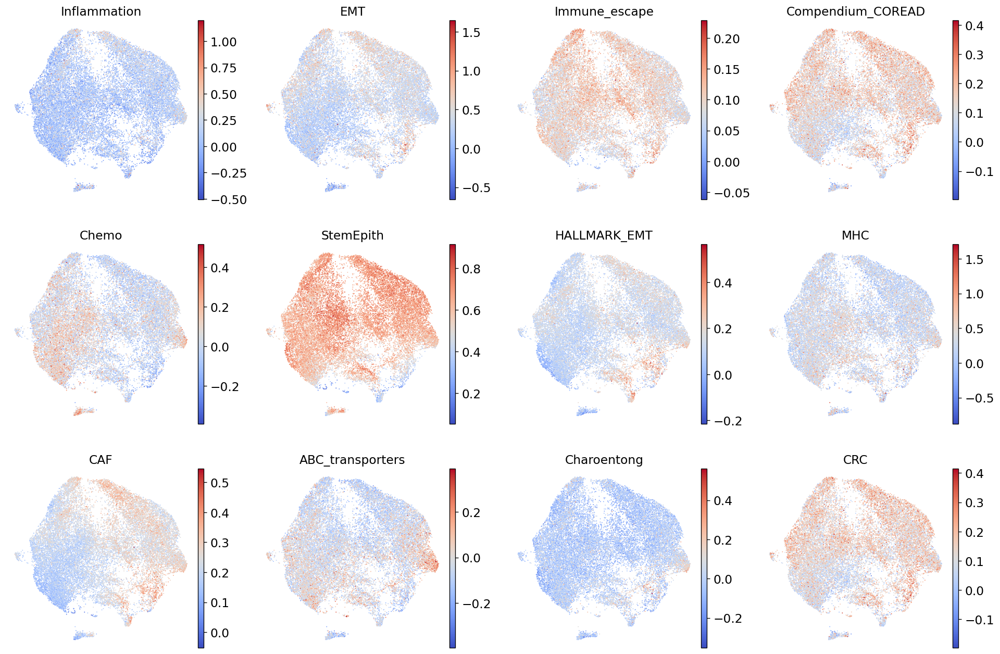

In [8]:
sc.settings.verbosity = 0
sc.settings.set_figure_params(dpi=60, facecolor="#FFFFFF", frameon=False, transparent=False, figsize=(4, 4))

import warnings
warnings.filterwarnings("ignore")

for file in gene_lists:
    file_path = os.path.join(gene_lists_folder,file)
    gene_df = pd.read_csv(file_path, sep="\t")
    gene_list_name = file.removesuffix(".tsv")
    gene_list = gene_df.iloc[:,0]
    total_nb = len(gene_list)
    print(f"{len(gene_list)} out of {total_nb} genes from the {gene_list_name} list are present in the dataset.")
    sc.tl.score_genes(adata, gene_list = gene_list, score_name=gene_list_name, use_raw = False)

gene_list_names = [file.removesuffix(".tsv") for file in gene_lists]
sc.pl.umap(adata, color=gene_list_names, color_map = "coolwarm")

4 out of 4 genes from the classical_class_I are present in the dataset.
0 out of 0 genes from the classical_class_II are present in the dataset.
0 out of 0 genes from the nonclass_class_I are present in the dataset.
0 out of 0 genes from the nonclass_class_II are present in the dataset.


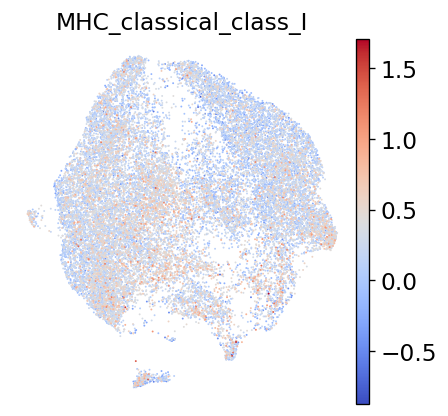

In [9]:
# different MHC classes
file_path = os.path.join(gene_lists_folder,"MHC.tsv")
gene_df = pd.read_csv(file_path, sep="\t")
classes = gene_df.iloc[:,1].unique()
present_classes = []

for mhc_class in classes:
    gene_df_class = gene_df[gene_df.iloc[:,1] == mhc_class]
    gene_list_name = f"MHC_{mhc_class}"
    # are the genes in the gene list present in the adata object?
    gene_list = gene_df_class.iloc[:,0]
    gene_list = gene_list[gene_list.isin(adata.var_names)]
    total_nb = len(gene_list)
    print(f"{len(gene_list)} out of {total_nb} genes from the {mhc_class} are present in the dataset.")
    if len(gene_list) > 0:
        sc.tl.score_genes(adata, gene_list = gene_list, score_name=gene_list_name, use_raw = False)
        present_classes.append(gene_list_name)

sc.pl.umap(adata, color=present_classes, color_map = "coolwarm")

12 out of 12 genes from the ACC term are present in the dataset.
13 out of 13 genes from the ACY term are present in the dataset.


25 out of 25 genes from the ALL term are present in the dataset.
46 out of 46 genes from the AML term are present in the dataset.
10 out of 10 genes from the AN term are present in the dataset.
7 out of 7 genes from the ANGS term are present in the dataset.
1 out of 1 genes from the ATRT term are present in the dataset.
9 out of 9 genes from the BC term are present in the dataset.
6 out of 6 genes from the BCNET term are present in the dataset.
67 out of 67 genes from the BLCA term are present in the dataset.
10 out of 10 genes from the BLY term are present in the dataset.
75 out of 75 genes from the BRCA term are present in the dataset.
42 out of 42 genes from the CESC term are present in the dataset.
40 out of 40 genes from the CH term are present in the dataset.
37 out of 37 genes from the CLL term are present in the dataset.
57 out of 57 genes from the CM term are present in the dataset.
60 out of 60 genes from the COREAD term are present in the dataset.
65 out of 65 genes from the

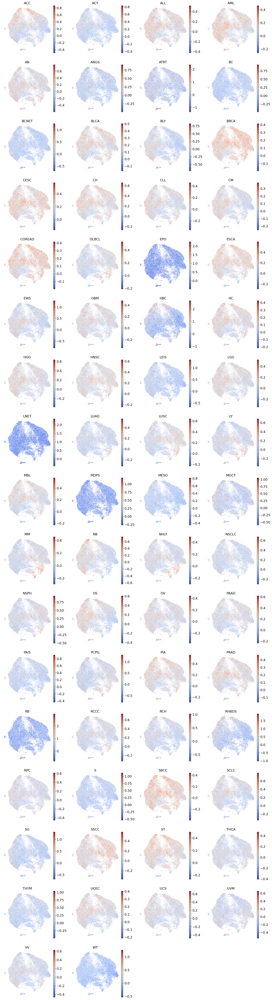

In [10]:
# different Compendium terms
file_path = os.path.join(gene_set_lists_folder,"Compendium.tsv")
gene_df = pd.read_csv(file_path, sep="\t")
terms = gene_df.iloc[:,0].unique()
present_terms = []

for term in terms:
    gene_df_class = gene_df[gene_df.iloc[:,0] == term]
    gene_list_name = term
    # are the genes in the gene list present in the adata object?
    gene_list = gene_df_class.iloc[:,1]
    gene_list = gene_list[gene_list.isin(adata.var_names)]
    total_nb = len(gene_list)
    print(f"{len(gene_list)} out of {total_nb} genes from the {term} term are present in the dataset.")
    if len(gene_list) > 0:
        sc.tl.score_genes(adata, gene_list = gene_list, score_name=gene_list_name, use_raw = False)
        present_terms.append(gene_list_name)

sc.pl.umap(adata, color=present_terms, color_map = "coolwarm")

91 out of 91 genes from the Sphingolipid term are present in the dataset
108 out of 108 genes from the cAMP term are present in the dataset


114 out of 114 genes from the Cell cycle term are present in the dataset
70 out of 70 genes from the ErbB term are present in the dataset
137 out of 137 genes from the Ras term are present in the dataset
47 out of 47 genes from the PPAR term are present in the dataset
95 out of 95 genes from the AMPK term are present in the dataset
111 out of 111 genes from the Insulin term are present in the dataset
95 out of 95 genes from the Cytokine-cytokine receptor interaction term are present in the dataset
74 out of 74 genes from the Apelin term are present in the dataset
106 out of 106 genes from the Hippo term are present in the dataset
123 out of 123 genes from the Rap1 term are present in the dataset
91 out of 91 genes from the Thyroid hormone term are present in the dataset
54 out of 54 genes from the TGF-beta term are present in the dataset
40 out of 40 genes from the Notch term are present in the dataset
84 out of 84 genes from the Calcium term are present in the dataset
96 out of 96 gen

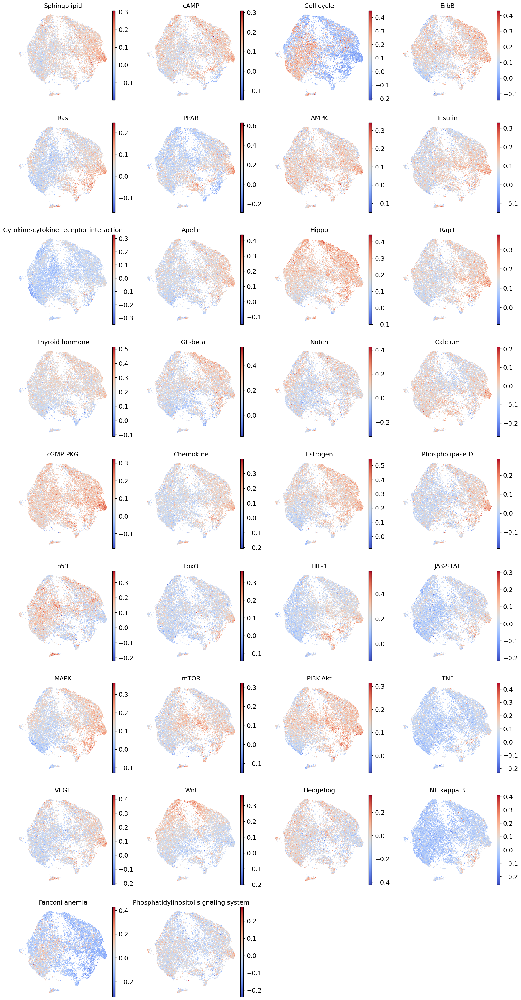

In [11]:
file_path = os.path.join(gene_set_lists_folder,"KEGG.tsv")
gene_df = pd.read_csv(file_path, sep="\t")
terms = gene_df.iloc[:,0].unique()
present_terms = []

for term in terms:
    gene_df_class = gene_df[gene_df.iloc[:,0] == term]
    gene_list_name = term
    # are the genes in the gene list present in the adata object?
    gene_list = gene_df_class.iloc[:,1]
    gene_list = gene_list[gene_list.isin(adata.var_names)]
    total_nb = len(gene_list)
    print(f"{len(gene_list)} out of {total_nb} genes from the {term} term are present in the dataset")
    if len(gene_list) > 0:
        sc.tl.score_genes(adata, gene_list = gene_list, score_name=gene_list_name, use_raw = False)
        present_terms.append(gene_list_name)

sc.pl.umap(adata, color=present_terms, color_map = "coolwarm")

2380 out of 2380 genes from the Epithelial term are present in the dataset.


3570 out of 3570 genes from the Immune term are present in the dataset.
1261 out of 1261 genes from the Stromal term are present in the dataset.


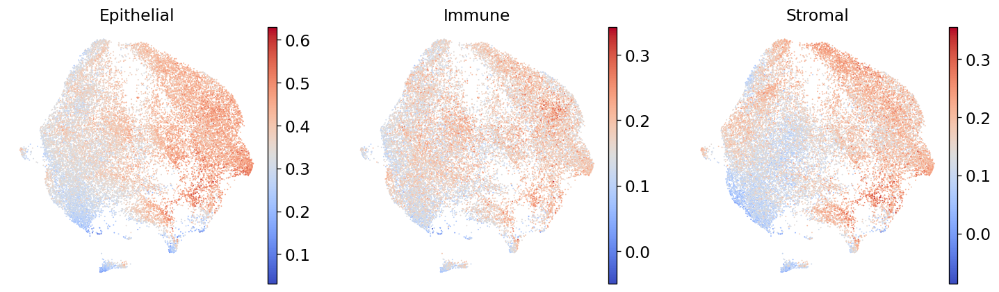

In [12]:
file_path = os.path.join(gene_set_lists_folder,"Markers.tsv")
gene_df = pd.read_csv(file_path, sep="\t")
terms = gene_df.iloc[:,2].unique()
present_terms = []

for term in terms:
    gene_df_class = gene_df[gene_df.iloc[:,2] == term]
    gene_list_name = term
    # are the genes in the gene list present in the adata object?
    gene_list = gene_df_class.iloc[:,1]
    gene_list = gene_list[gene_list.isin(adata.var_names)]
    total_nb = len(gene_list)
    print(f"{len(gene_list)} out of {total_nb} genes from the {term} term are present in the dataset.")
    if len(gene_list) > 0:
        sc.tl.score_genes(adata, gene_list = gene_list, score_name=gene_list_name, use_raw = False)
        present_terms.append(gene_list_name)

sc.pl.umap(adata, color=present_terms, color_map = "coolwarm")

In [13]:
gene_df
# remove immune category
gene_df = gene_df[gene_df.iloc[:,2] != "Immune"]
gene_df

,TERM,SYMBOL,CATEGORY,LIST
0,Stem,PLA2G2A,Epithelial,Markers
1,Stem,OLFM4,Epithelial,Markers
2,Stem,LEFTY1,Epithelial,Markers
3,Stem,PIGR,Epithelial,Markers
4,Stem,LCN2,Epithelial,Markers
...,...,...,...,...
10559,Endothelial,IFNGR1,Stromal,Markers
10560,Endothelial,NCOA3,Stromal,Markers
10561,Endothelial,LIMA1,Stromal,Markers
10562,Endothelial,CD40,Stromal,Markers


254 out of 254 genes from the Stem term are present in the dataset.


54 out of 54 genes from the Stem/TA 1 term are present in the dataset.
1 out of 1 genes from the Stem/TA 2 term are present in the dataset.
1 out of 1 genes from the Stem/TA 3 term are present in the dataset.
21 out of 21 genes from the Ent. Prog. 1 term are present in the dataset.
151 out of 151 genes from the Ent. Prog. 2 term are present in the dataset.
389 out of 389 genes from the Enterocytes 1 term are present in the dataset.
129 out of 129 genes from the Enterocytes 2 term are present in the dataset.
106 out of 106 genes from the Enterocytes 3 term are present in the dataset.
16 out of 16 genes from the Imma. Gob. 1 term are present in the dataset.
129 out of 129 genes from the Imma. Gob. 2 term are present in the dataset.
189 out of 189 genes from the Goblet term are present in the dataset.
119 out of 119 genes from the Tuft term are present in the dataset.
352 out of 352 genes from the TC1 term are present in the dataset.
10 out of 10 genes from the TC2 term are present in the

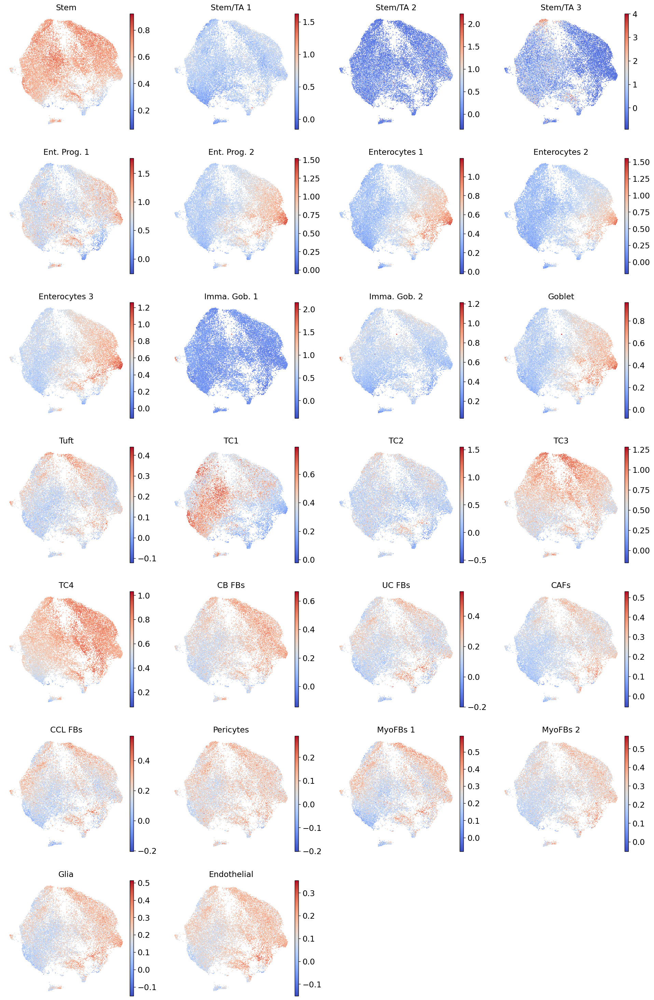

In [14]:
file_path = os.path.join(gene_set_lists_folder,"Markers.tsv")
gene_df = pd.read_csv(file_path, sep="\t")

# remove immune category
gene_df = gene_df[gene_df.iloc[:,2] != "Immune"]

terms = gene_df.iloc[:,0].unique()
present_terms = []

for term in terms:
    gene_df_class = gene_df[gene_df.iloc[:,0] == term]
    gene_list_name = term
    # are the genes in the gene list present in the adata object?
    gene_list = gene_df_class.iloc[:,1]
    gene_list = gene_list[gene_list.isin(adata.var_names)]
    total_nb = len(gene_list)
    print(f"{len(gene_list)} out of {total_nb} genes from the {term} term are present in the dataset.")
    if len(gene_list) > 0:
        sc.tl.score_genes(adata, gene_list = gene_list, score_name=gene_list_name, use_raw = False)
        present_terms.append(gene_list_name)

sc.pl.umap(adata, color=present_terms, color_map = "coolwarm")